<a href="https://colab.research.google.com/github/a-tasnim/ML-DL-projects/blob/main/ToN_IoT_MLP_with_Lime.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import pandas as pd
from sklearn.preprocessing import RobustScaler

from sklearn.neural_network import MLPClassifier
from sklearn.model_selection import train_test_split # Import train_test_split function
from sklearn import metrics #Import scikit-learn metrics module for accuracy calculation
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import confusion_matrix
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import classification_report


In [ ]:
!pip install lime	
import lime
from lime import lime_tabular

     |████████████████████████████████| 275 kB 8.4 MB/s 
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283857 sha256=6cb4d4a1db903eb383fd45dfcdd58b4c479b4f4c649f382927f08ce2345bd3fd
  Stored in directory: /root/.cache/pip/wheels/ca/cb/e5/ac701e12d365a08917bf4c6171c0961bc880a8181359c66aa7
Successfully built lime


In [ ]:
!pip install shap
import shap

     |████████████████████████████████| 564 kB 6.4 MB/s 


# IoT Fridge

In [ ]:
#IoT Fridge
data = pd.read_csv('/content/drive/MyDrive/ToN_IoT_dataset/Processed_IoT_dataset/IoT_Fridge.csv')



In [ ]:
data



,date,time,fridge_temperature,temp_condition,label,type
0,31-Mar-19,12:36:52,13.10,high,0,normal
1,31-Mar-19,12:36:53,8.65,high,0,normal
2,31-Mar-19,12:36:54,2.00,low,0,normal
3,31-Mar-19,12:36:55,4.80,low,0,normal
4,31-Mar-19,12:36:56,10.70,high,0,normal
...,...,...,...,...,...,...
587071,27-Apr-19,12:41:17,4.00,low,0,normal
587072,27-Apr-19,12:41:17,6.05,high,0,normal
587073,27-Apr-19,12:41:17,12.80,high,0,normal
587074,27-Apr-19,12:41:18,6.50,high,0,normal


In [ ]:
print(data.shape)
print("No of rows",data.shape[0])
print("No of columns",data.shape[1])

(587076, 6)
No of rows 587076
No of columns 6


In [ ]:

inputs = data.drop(['label','type'],axis = 'columns')
features = inputs.columns
target_var_data = data['type']

#Creating the dependent variable class
factor = pd.factorize(data['type'])
target_var = factor[0]
definitions = factor[1]
print(list(definitions))
print(len(target_var_data) )

['normal', 'backdoor', 'ddos', 'injection', 'password', 'ransomware', 'xss']
587076


In [ ]:
inputs

,date,time,fridge_temperature,temp_condition
0,31-Mar-19,12:36:52,13.10,high
1,31-Mar-19,12:36:53,8.65,high
2,31-Mar-19,12:36:54,2.00,low
3,31-Mar-19,12:36:55,4.80,low
4,31-Mar-19,12:36:56,10.70,high
...,...,...,...,...
587071,27-Apr-19,12:41:17,4.00,low
587072,27-Apr-19,12:41:17,6.05,high
587073,27-Apr-19,12:41:17,12.80,high
587074,27-Apr-19,12:41:18,6.50,high


In [ ]:
le_date = LabelEncoder()
le_time = LabelEncoder()
le_fridge_temperature = LabelEncoder()
le_temp_condition = LabelEncoder()

In [ ]:
inputs['date_n'] = le_date.fit_transform(inputs['date'])
inputs['time_n'] = le_time.fit_transform(inputs['time'])
inputs['fridge_temperature_n'] = le_fridge_temperature.fit_transform(inputs['fridge_temperature'])
inputs['temp_condition_n'] = le_temp_condition.fit_transform(inputs['temp_condition'])
inputs.head()


,date,time,fridge_temperature,temp_condition,date_n,time_n,fridge_temperature_n,temp_condition_n
0,31-Mar-19,12:36:52,13.10,high,11,10707,144,1
1,31-Mar-19,12:36:53,8.65,high,11,10708,94,1
2,31-Mar-19,12:36:54,2.00,low,11,10709,7,4
3,31-Mar-19,12:36:55,4.80,low,11,10710,40,4
4,31-Mar-19,12:36:56,10.70,high,11,10711,117,1


In [ ]:
new_inputs = inputs.drop(['date','time','fridge_temperature','temp_condition'],axis = 'columns')
new_inputs.head()

,date_n,time_n,fridge_temperature_n,temp_condition_n
0,11,10707,144,1
1,11,10708,94,1
2,11,10709,7,4
3,11,10710,40,4
4,11,10711,117,1


In [ ]:
#split dataset in features and target variable
feature_cols = ['date_n', 'time_n', 'fridge_temperature_n', 'temp_condition_n']
X = new_inputs[feature_cols] # Features
y = target_var # Target variable


In [ ]:
# Split dataset into training set and test set
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=1,stratify=pd.DataFrame(y)) # 70% training and 30% test


In [ ]:
scaler = RobustScaler()

X_train = scaler.fit_transform(X_train)

X_test = scaler.transform(X_test)


In [ ]:
#Create a Gaussian Classifier
clf=MLPClassifier(hidden_layer_sizes=(6,5),random_state=5,verbose=True,learning_rate_init=0.01)

#Train the model using the training sets y_pred=clf.predict(X_test)
clf.fit(X_train,y_train)

# prediction on test set
y_pred=clf.predict(X_test)




Iteration 1, loss = 0.16264534
Iteration 2, loss = 0.06026249
Iteration 3, loss = 0.05477807
Iteration 4, loss = 0.05291709
Iteration 5, loss = 0.05152069
Iteration 6, loss = 0.05181683
Iteration 7, loss = 0.05151281
Iteration 8, loss = 0.05055384
Iteration 9, loss = 0.04999524
Iteration 10, loss = 0.05016250
Iteration 11, loss = 0.05018333
Iteration 12, loss = 0.04973275
Iteration 13, loss = 0.04980958
Iteration 14, loss = 0.04908508
Iteration 15, loss = 0.04927958
Iteration 16, loss = 0.04892179
Iteration 17, loss = 0.04878043
Iteration 18, loss = 0.04810635
Iteration 19, loss = 0.04893323
Iteration 20, loss = 0.04811524
Iteration 21, loss = 0.04799011
Iteration 22, loss = 0.04828019
Iteration 23, loss = 0.04770403
Iteration 24, loss = 0.04746187
Iteration 25, loss = 0.04793902
Iteration 26, loss = 0.04811500
Iteration 27, loss = 0.04767406
Iteration 28, loss = 0.04758673
Iteration 29, loss = 0.04779796
Iteration 30, loss = 0.04710225
Iteration 31, loss = 0.04757260
Iteration 32, los

In [ ]:
print(len(X_test))

176123


In [ ]:
#Reverse factorize 
reversefactor = dict(zip(range(len(definitions)),definitions))
y_test = np.vectorize(reversefactor.get)(y_test)
y_pred = np.vectorize(reversefactor.get)(y_pred)

In [ ]:
print(len(y_pred))

176123


In [ ]:
# Model Accuracy, how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test, y_pred))

Accuracy: 0.9809508127842473


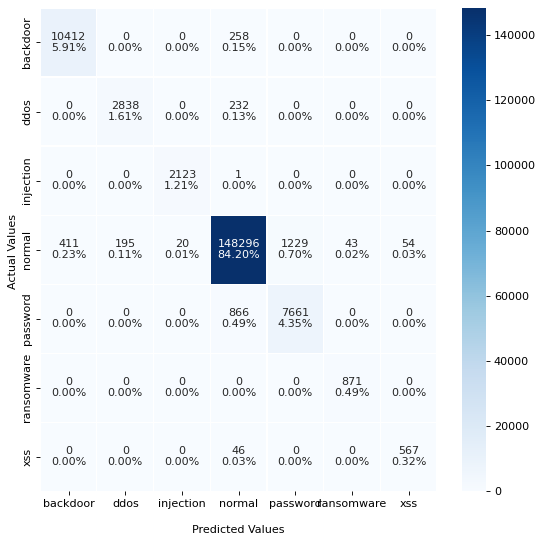

In [ ]:

conf_matrix = confusion_matrix(y_test, y_pred)
group_counts = ["{0:0.0f}".format(value) for value in conf_matrix.flatten()]
group_percentages = ["{0:.2%}".format(value) for value in conf_matrix.flatten()/np.sum(conf_matrix)]
labels = [f"{v1}\n{v2}" for v1, v2 in zip(group_counts,group_percentages)]


fig = plt.figure(num=None, figsize=(8, 8), dpi=80, facecolor='w', edgecolor='k')
labels = np.asarray(labels).reshape(7,7)
ax = sns.heatmap(conf_matrix, annot=labels, fmt="", cmap='Blues',linewidths=0.1)
ax.set_xlabel('\nPredicted Values')
ax.set_ylabel('Actual Values ');

ax.xaxis.set_ticklabels(['backdoor','ddos','injection','normal','password','ransomware','xss'])
ax.yaxis.set_ticklabels(['backdoor','ddos','injection','normal','password','ransomware','xss'])
plt.show()

In [ ]:

print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

    backdoor       0.96      0.98      0.97     10670
        ddos       0.94      0.92      0.93      3070
   injection       0.99      1.00      1.00      2124
      normal       0.99      0.99      0.99    150248
    password       0.86      0.90      0.88      8527
  ransomware       0.95      1.00      0.98       871
         xss       0.91      0.92      0.92       613

    accuracy                           0.98    176123
   macro avg       0.94      0.96      0.95    176123
weighted avg       0.98      0.98      0.98    176123



**Lime**

In [ ]:
#np.array(X_train)
explainer = lime_tabular.LimeTabularExplainer(training_data= np.array(X_train), mode="classification",
                                              class_names=list(definitions),
                                              feature_names= features
                                             )
explainer

In [ ]:
import random as rn 
for i in range(1,4):
    print("Test sample",(i),":")
    idx = rn.randint(0,len(X_test))

    print("Prediction : ", definitions[clf.predict(X_test[idx].reshape(1,-1))[0]])
    print("Actual :     ",  y_test[idx])


    exp = explainer.explain_instance(pd.DataFrame(X_test).iloc[idx], clf.predict_proba,top_labels=4)

    exp.show_in_notebook(show_table = True)
    print()

# IoT GPS tracker

In [ ]:
#IoT GPS tracker
data = pd.read_csv('/content/drive/MyDrive/ToN_IoT_dataset/Processed_IoT_dataset/IoT_GPS_Tracker.csv')

In [ ]:
data

,date,time,latitude,longitude,label,type
0,31-Mar-19,12:36:52,0.000000,10.000000,0,normal
1,31-Mar-19,12:36:53,0.000000,10.000000,0,normal
2,31-Mar-19,12:36:54,0.000000,10.000000,0,normal
3,31-Mar-19,12:36:55,0.000000,10.000000,0,normal
4,31-Mar-19,12:36:56,0.000000,10.000000,0,normal
...,...,...,...,...,...,...
595681,27-Apr-19,12:41:16,182.523268,190.867134,0,normal
595682,27-Apr-19,12:41:16,183.122818,191.159551,0,normal
595683,27-Apr-19,12:41:17,247.820755,261.905963,0,normal
595684,27-Apr-19,12:41:17,246.000740,264.091992,0,normal


In [ ]:
print(data.shape)
print("No of rows",data.shape[0])
print("No of columns",data.shape[1])

(595686, 6)
No of rows 595686
No of columns 6


In [ ]:

inputs = data.drop(['label','type'],axis = 'columns')
features = inputs.columns

target_var_data = data['type']

#Creating the dependent variable class
factor = pd.factorize(data['type'])
target_var = factor[0]
definitions = factor[1]
print(list(definitions))

['normal', 'backdoor', 'ddos', 'injection', 'password', 'ransomware', 'scanning', 'xss']


In [ ]:
le_date = LabelEncoder()
le_time = LabelEncoder()
le_latitude = LabelEncoder()
le_longitude = LabelEncoder()

In [ ]:
inputs['date_n'] = le_date.fit_transform(inputs['date'])
inputs['time_n'] = le_time.fit_transform(inputs['time'])
inputs['latitude_n'] = le_latitude.fit_transform(inputs['latitude'])
inputs['longitude_n'] = le_longitude.fit_transform(inputs['longitude'])
inputs.head()

,date,time,latitude,longitude,date_n,time_n,latitude_n,longitude_n
0,31-Mar-19,12:36:52,0.0,10.0,11,84384,0,0
1,31-Mar-19,12:36:53,0.0,10.0,11,84385,0,0
2,31-Mar-19,12:36:54,0.0,10.0,11,84386,0,0
3,31-Mar-19,12:36:55,0.0,10.0,11,84387,0,0
4,31-Mar-19,12:36:56,0.0,10.0,11,84388,0,0


In [ ]:
new_inputs = inputs.drop(['date','time','latitude','longitude'],axis = 'columns')
new_inputs.head()

,date_n,time_n,latitude_n,longitude_n
0,11,84384,0,0
1,11,84385,0,0
2,11,84386,0,0
3,11,84387,0,0
4,11,84388,0,0


In [ ]:
#split dataset in features and target variable
feature_cols = ['date_n', 'time_n', 'latitude_n', 'longitude_n']
X = new_inputs[feature_cols] # Features
y = target_var # Target variable

In [ ]:
# Split dataset into training set and test set
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=1,stratify=pd.DataFrame(y)) # 70% training and 30% test

In [ ]:
X_train_columns = X_train.columns

In [ ]:
scaler = RobustScaler()

X_train = scaler.fit_transform(X_train)

X_test = scaler.transform(X_test)

In [ ]:
#Create a Gaussian Classifier
clf=MLPClassifier(hidden_layer_sizes=(6,5),random_state=5,verbose=True,learning_rate_init=0.01)

#Train the model using the training sets y_pred=clf.predict(X_test)
clf.fit(X_train,y_train)

# prediction on test set
y_pred=clf.predict(X_test)



Iteration 1, loss = 0.40838445
Iteration 2, loss = 0.20344151
Iteration 3, loss = 0.17703273
Iteration 4, loss = 0.15749770
Iteration 5, loss = 0.14982433
Iteration 6, loss = 0.14453693
Iteration 7, loss = 0.14171723
Iteration 8, loss = 0.13930248
Iteration 9, loss = 0.13760922
Iteration 10, loss = 0.13594629
Iteration 11, loss = 0.13507526
Iteration 12, loss = 0.13409402
Iteration 13, loss = 0.13298185
Iteration 14, loss = 0.13215101
Iteration 15, loss = 0.13120992
Iteration 16, loss = 0.13063294
Iteration 17, loss = 0.13026427
Iteration 18, loss = 0.12914771
Iteration 19, loss = 0.12872360
Iteration 20, loss = 0.12842299
Iteration 21, loss = 0.12729730
Iteration 22, loss = 0.12845477
Iteration 23, loss = 0.12703354
Iteration 24, loss = 0.12654677
Iteration 25, loss = 0.12692312
Iteration 26, loss = 0.12583035
Iteration 27, loss = 0.12574411
Iteration 28, loss = 0.12523595
Iteration 29, loss = 0.12510841
Iteration 30, loss = 0.12452406
Iteration 31, loss = 0.12473863
Iteration 32, los

In [ ]:
#Reverse factorize 
reversefactor = dict(zip(range(len(definitions)),definitions))
y_test = np.vectorize(reversefactor.get)(y_test)
y_pred = np.vectorize(reversefactor.get)(y_pred)

In [ ]:
# Model Accuracy, how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test, y_pred))

Accuracy: 0.9637225386948396


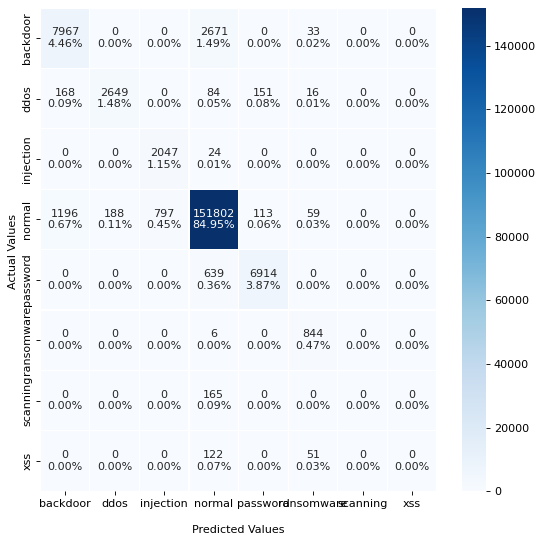

In [ ]:

conf_matrix = confusion_matrix(y_test, y_pred)
group_counts = ["{0:0.0f}".format(value) for value in conf_matrix.flatten()]
group_percentages = ["{0:.2%}".format(value) for value in conf_matrix.flatten()/np.sum(conf_matrix)]
labels = [f"{v1}\n{v2}" for v1, v2 in zip(group_counts,group_percentages)]


fig = plt.figure(num=None, figsize=(8, 8), dpi=80, facecolor='w', edgecolor='k')
labels = np.asarray(labels).reshape(8,8)
ax = sns.heatmap(conf_matrix, annot=labels, fmt="", cmap='Blues',linewidths=0.1)
ax.set_xlabel('\nPredicted Values')
ax.set_ylabel('Actual Values ');

ax.xaxis.set_ticklabels(['backdoor', 'ddos', 'injection', 'normal', 'password','ransomware', 'scanning', 'xss'])
ax.yaxis.set_ticklabels(['backdoor', 'ddos', 'injection', 'normal', 'password','ransomware', 'scanning', 'xss'])
plt.show()

In [ ]:


print(classification_report(y_test, y_pred))

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

    backdoor       0.85      0.75      0.80     10671
        ddos       0.93      0.86      0.90      3068
   injection       0.72      0.99      0.83      2071
      normal       0.98      0.98      0.98    154155
    password       0.96      0.92      0.94      7553
  ransomware       0.84      0.99      0.91       850
    scanning       0.00      0.00      0.00       165
         xss       0.00      0.00      0.00       173

    accuracy                           0.96    178706
   macro avg       0.66      0.69      0.67    178706
weighted avg       0.96      0.96      0.96    178706



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


**Lime**

In [ ]:
explainer = lime_tabular.LimeTabularExplainer(training_data= np.array(X_train), mode="classification",
                                              class_names=list(definitions),
                                              feature_names= features
                                             )
explainer

In [ ]:
import random as rn 
for i in range(1,4):
    print("Test sample",(i),":")
    idx = rn.randint(0,len(X_test))

    print("Prediction : ", definitions[clf.predict(X_test[idx].reshape(1,-1))[0]])
    print("Actual :     ",  y_test[idx])


    exp = explainer.explain_instance(pd.DataFrame(X_test).iloc[idx], clf.predict_proba,top_labels=4)

    exp.show_in_notebook(show_table = True)
    print()

Test sample 1 :
Prediction :  normal
Actual :      normal



Test sample 2 :
Prediction :  ransomware
Actual :      ransomware



Test sample 3 :
Prediction :  normal
Actual :      normal


#IoT Garage Door

In [ ]:
#IoT Garage Door
data = pd.read_csv('/content/drive/MyDrive/ToN_IoT_dataset/Processed_IoT_dataset/IoT_Garage_Door.csv')

Columns (3) have mixed types.Specify dtype option on import or set low_memory=False.


In [ ]:
data

,date,time,door_state,sphone_signal,label,type
0,1-Apr-19,20:53:44,open,true,0,normal
1,1-Apr-19,20:53:49,closed,false,0,normal
2,1-Apr-19,20:53:49,open,true,0,normal
3,1-Apr-19,20:53:54,closed,false,0,normal
4,1-Apr-19,20:53:54,open,true,0,normal
...,...,...,...,...,...,...
591441,27-Apr-19,11:03:21,closed,0.0,0,normal
591442,27-Apr-19,11:03:21,closed,0.0,0,normal
591443,27-Apr-19,11:03:21,closed,0.0,0,normal
591444,27-Apr-19,11:03:22,closed,0.0,0,normal


In [ ]:
print(data.shape)
print("No of rows",data.shape[0])
print("No of columns",data.shape[1])

(591446, 6)
No of rows 591446
No of columns 6


In [ ]:
data = data.dropna(axis = 0,subset=['date', 'time','door_state', 'sphone_signal'])

In [ ]:
inputs = data.drop(['label','type'],axis = 'columns')
target_var = data['type']
features = inputs.columns

#Creating the dependent variable class
factor = pd.factorize(data['type'])
target_var = factor[0]
definitions = factor[1]
print(target_var)

[0 0 0 ... 0 0 0]


In [ ]:
le_date = LabelEncoder()
le_time = LabelEncoder()
le_door_state = LabelEncoder()
le_sphone_signal = LabelEncoder()

In [ ]:
inputs['date_n'] = le_date.fit_transform(inputs['date'].astype('str'))
inputs['time_n'] = le_time.fit_transform(inputs['time'].astype('str'))
inputs['door_state_n'] = le_door_state.fit_transform(inputs['door_state'].astype('str'))
inputs['sphone_signal_n'] = le_sphone_signal.fit_transform(inputs['sphone_signal'].astype('str'))
inputs.head()

,date,time,door_state,sphone_signal,date_n,time_n,door_state_n,sphone_signal_n
0,1-Apr-19,20:53:44,open,true,0,28286,1,5
1,1-Apr-19,20:53:49,closed,false,0,28287,0,4
2,1-Apr-19,20:53:49,open,true,0,28287,1,5
3,1-Apr-19,20:53:54,closed,false,0,28288,0,4
4,1-Apr-19,20:53:54,open,true,0,28288,1,5


In [ ]:
new_inputs = inputs.drop(['date','time','door_state','sphone_signal'],axis = 'columns')
new_inputs.head()

,date_n,time_n,door_state_n,sphone_signal_n
0,0,28286,1,5
1,0,28287,0,4
2,0,28287,1,5
3,0,28288,0,4
4,0,28288,1,5


In [ ]:
#split dataset in features and target variable
feature_cols = ['date_n', 'time_n', 'door_state_n', 'sphone_signal_n']
X = new_inputs[feature_cols] # Features
y = target_var # Target variable

In [ ]:
# Split dataset into training set and test set
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=1,stratify=pd.DataFrame(y)) # 70% training and 30% test

In [ ]:
scaler = RobustScaler()

X_train = scaler.fit_transform(X_train)

X_test = scaler.transform(X_test)

In [ ]:
#Create a Gaussian Classifier
clf=MLPClassifier(hidden_layer_sizes=(6,5),random_state=5,verbose=True,learning_rate_init=0.01)

#Train the model using the training sets y_pred=clf.predict(X_test)
clf.fit(X_train,y_train)

# prediction on test set
y_pred=clf.predict(X_test)


Iteration 1, loss = 0.35881441
Iteration 2, loss = 0.12890898
Iteration 3, loss = 0.11933978
Iteration 4, loss = 0.11640335
Iteration 5, loss = 0.11537341
Iteration 6, loss = 0.11461578
Iteration 7, loss = 0.11456769
Iteration 8, loss = 0.11392088
Iteration 9, loss = 0.11418751
Iteration 10, loss = 0.11441312
Iteration 11, loss = 0.11287170
Iteration 12, loss = 0.11337066
Iteration 13, loss = 0.11334571
Iteration 14, loss = 0.11367787
Iteration 15, loss = 0.11303308
Iteration 16, loss = 0.11295539
Iteration 17, loss = 0.11317353
Iteration 18, loss = 0.11299351
Iteration 19, loss = 0.11239485
Iteration 20, loss = 0.11177000
Iteration 21, loss = 0.11155975
Iteration 22, loss = 0.11134318
Iteration 23, loss = 0.11073309
Iteration 24, loss = 0.11086172
Iteration 25, loss = 0.11033249
Iteration 26, loss = 0.10905242
Iteration 27, loss = 0.10661357
Iteration 28, loss = 0.10423396
Iteration 29, loss = 0.10350014
Iteration 30, loss = 0.10300468
Iteration 31, loss = 0.10287735
Iteration 32, los

In [ ]:
#Reverse factorize 
reversefactor = dict(zip(range(len(definitions)),definitions))
y_test = np.vectorize(reversefactor.get)(y_test)
y_pred = np.vectorize(reversefactor.get)(y_pred)

In [ ]:
# Model Accuracy, how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test, y_pred))

Accuracy: 0.9822018327941657


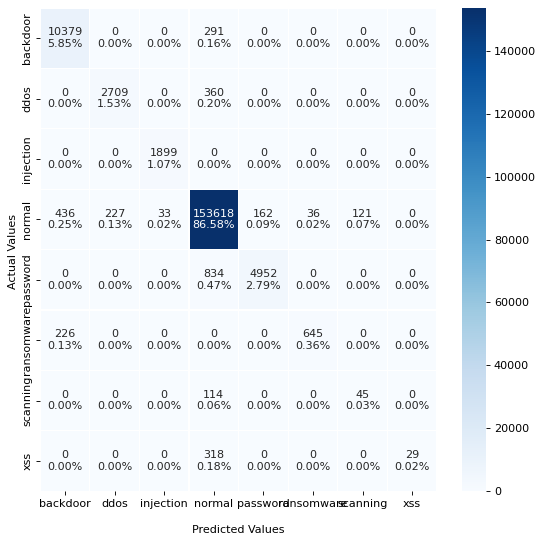

In [ ]:
conf_matrix = confusion_matrix(y_test, y_pred)
group_counts = ["{0:0.0f}".format(value) for value in conf_matrix.flatten()]
group_percentages = ["{0:.2%}".format(value) for value in conf_matrix.flatten()/np.sum(conf_matrix)]
labels = [f"{v1}\n{v2}" for v1, v2 in zip(group_counts,group_percentages)]


fig = plt.figure(num=None, figsize=(8, 8), dpi=80, facecolor='w', edgecolor='k')
labels = np.asarray(labels).reshape(8,8)
ax = sns.heatmap(conf_matrix, annot=labels, fmt="", cmap='Blues',linewidths=0.1)
ax.set_xlabel('\nPredicted Values')
ax.set_ylabel('Actual Values ');

ax.xaxis.set_ticklabels(['backdoor', 'ddos', 'injection', 'normal', 'password','ransomware', 'scanning', 'xss'])
ax.yaxis.set_ticklabels(['backdoor', 'ddos', 'injection', 'normal', 'password','ransomware', 'scanning', 'xss'])
plt.show()

In [ ]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

    backdoor       0.94      0.97      0.96     10670
        ddos       0.92      0.88      0.90      3069
   injection       0.98      1.00      0.99      1899
      normal       0.99      0.99      0.99    154633
    password       0.97      0.86      0.91      5786
  ransomware       0.95      0.74      0.83       871
    scanning       0.27      0.28      0.28       159
         xss       1.00      0.08      0.15       347

    accuracy                           0.98    177434
   macro avg       0.88      0.73      0.75    177434
weighted avg       0.98      0.98      0.98    177434



**Lime**

In [ ]:
explainer = lime_tabular.LimeTabularExplainer(training_data= np.array(X_train), mode="classification",
                                              class_names=list(definitions),
                                              feature_names= features
                                             )
explainer

In [ ]:
import random as rn 
for i in range(1,4):
    print("Test sample",(i),":")
    idx = rn.randint(0,len(X_test))

    print("Prediction : ", definitions[clf.predict(X_test[idx].reshape(1,-1))[0]])
    print("Actual :     ",  y_test[idx])


    exp = explainer.explain_instance(pd.DataFrame(X_test).iloc[idx], clf.predict_proba,top_labels=4)

    exp.show_in_notebook(show_table = True)
    print()

Test sample 1 :
Prediction :  password
Actual :      password



Test sample 2 :
Prediction :  normal
Actual :      normal



Test sample 3 :
Prediction :  normal
Actual :      normal


**SHAP**

In [ ]:
explainer = shap.KernelExplainer(clf.predict,shap.kmeans(X_train,10))
shap_values = explainer.shap_values(X_test)

  0%|          | 0/162354 [00:00<?, ?it/s]

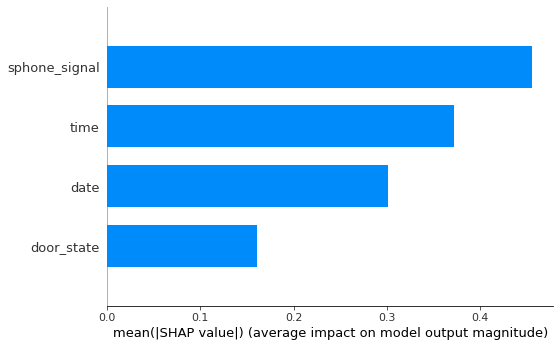

In [ ]:
shap.summary_plot(shap_values, X_test,plot_type = 'bar',feature_names = features,class_names = list(definitions),class_inds = "original" ,plot_size = 1)


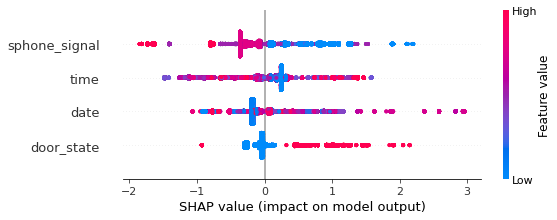

In [ ]:
shap.summary_plot(shap_values, X_test,feature_names = features )


#IoT Modbus


In [ ]:
#IoT Modbus
data = pd.read_csv('/content/drive/MyDrive/ToN_IoT_dataset/Processed_IoT_dataset/IoT_Modbus.csv')

In [ ]:
data

,date,time,FC1_Read_Input_Register,FC2_Read_Discrete_Value,FC3_Read_Holding_Register,FC4_Read_Coil,label,type
0,31-Mar-19,12:36:55,53287,1463,33518,23014,0,normal
1,31-Mar-19,12:36:58,41029,55891,26004,50645,0,normal
2,31-Mar-19,12:36:58,41029,55891,26004,50645,0,normal
3,31-Mar-19,12:37:00,64661,40232,33460,44046,0,normal
4,31-Mar-19,12:37:01,64661,40232,33460,44046,0,normal
...,...,...,...,...,...,...,...,...
287189,29-Apr-19,23:59:10,22798,40857,14335,58610,0,normal
287190,29-Apr-19,23:59:22,15838,54368,63613,45660,0,normal
287191,29-Apr-19,23:59:26,28674,60221,3792,17705,0,normal
287192,29-Apr-19,23:59:32,28674,60221,3792,17705,0,normal


In [ ]:
print(data.shape)
print("No of rows",data.shape[0])
print("No of columns",data.shape[1])

(287194, 8)
No of rows 287194
No of columns 8


In [ ]:

inputs = data.drop(['label','type'],axis = 'columns')

target_var_data = data['type']
features = inputs.columns

#Creating the dependent variable class
factor = pd.factorize(data['type'])
target_var = factor[0]
definitions = factor[1]
print(list(definitions))

['normal', 'scanning', 'injection', 'password', 'xss', 'backdoor']


In [ ]:
le_date = LabelEncoder()
le_time = LabelEncoder()
le_FC1_Read_Input_Register = LabelEncoder()
le_FC2_Read_Discrete_Value = LabelEncoder()
le_FC3_Read_Holding_Register = LabelEncoder()
le_FC4_Read_Coil = LabelEncoder()

In [ ]:
inputs['date_n'] = le_date.fit_transform(inputs['date'])
inputs['time_n'] = le_time.fit_transform(inputs['time'])
inputs['FC1_Read_Input_Register_n'] = le_FC1_Read_Input_Register.fit_transform(inputs['FC1_Read_Input_Register'])
inputs['FC2_Read_Discrete_Value_n'] = le_FC2_Read_Discrete_Value.fit_transform(inputs['FC2_Read_Discrete_Value'])
inputs['FC3_Read_Holding_Register_n'] = le_FC3_Read_Holding_Register.fit_transform(inputs['FC3_Read_Holding_Register'])
inputs['FC4_Read_Coil_n'] = le_FC4_Read_Coil.fit_transform(inputs['FC4_Read_Coil'])
inputs.head()

,date,time,FC1_Read_Input_Register,FC2_Read_Discrete_Value,FC3_Read_Holding_Register,FC4_Read_Coil,date_n,time_n,FC1_Read_Input_Register_n,FC2_Read_Discrete_Value_n,FC3_Read_Holding_Register_n,FC4_Read_Coil_n
0,31-Mar-19,12:36:55,53287,1463,33518,23014,11,30945,43655,1191,27347,18833
1,31-Mar-19,12:36:58,41029,55891,26004,50645,11,30948,33605,45731,21194,41548
2,31-Mar-19,12:36:58,41029,55891,26004,50645,11,78022,33605,45731,21194,41548
3,31-Mar-19,12:37:00,64661,40232,33460,44046,11,78024,52964,32970,27302,36114
4,31-Mar-19,12:37:01,64661,40232,33460,44046,11,78025,52964,32970,27302,36114


In [ ]:
new_inputs = inputs.drop(['date','time','FC1_Read_Input_Register','FC2_Read_Discrete_Value','FC3_Read_Holding_Register','FC4_Read_Coil'],axis = 'columns')
new_inputs.head()

,date_n,time_n,FC1_Read_Input_Register_n,FC2_Read_Discrete_Value_n,FC3_Read_Holding_Register_n,FC4_Read_Coil_n
0,11,30945,43655,1191,27347,18833
1,11,30948,33605,45731,21194,41548
2,11,78022,33605,45731,21194,41548
3,11,78024,52964,32970,27302,36114
4,11,78025,52964,32970,27302,36114


In [ ]:
#split dataset in features and target variable
feature_cols = ['date_n','time_n','FC1_Read_Input_Register_n','FC2_Read_Discrete_Value_n','FC3_Read_Holding_Register_n','FC4_Read_Coil_n']
X = new_inputs[feature_cols] # Features
y = target_var # Target variable

In [ ]:
# Split dataset into training set and test set
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=1,stratify=pd.DataFrame(y)) # 70% training and 30% test

In [ ]:
scaler = RobustScaler()

X_train = scaler.fit_transform(X_train)

X_test = scaler.transform(X_test)

In [ ]:
#Create a Gaussian Classifier
clf=MLPClassifier(hidden_layer_sizes=(6,5),random_state=5,verbose=True,learning_rate_init=0.01)

#Train the model using the training sets y_pred=clf.predict(X_test)
clf.fit(X_train,y_train)

# prediction on test set
y_pred=clf.predict(X_test)


Iteration 1, loss = 0.33534563
Iteration 2, loss = 0.17128773
Iteration 3, loss = 0.15770187
Iteration 4, loss = 0.15033817
Iteration 5, loss = 0.14757992
Iteration 6, loss = 0.14568797
Iteration 7, loss = 0.14435931
Iteration 8, loss = 0.14309991
Iteration 9, loss = 0.14142843
Iteration 10, loss = 0.14175430
Iteration 11, loss = 0.13904197
Iteration 12, loss = 0.13913171
Iteration 13, loss = 0.13751160
Iteration 14, loss = 0.13672740
Iteration 15, loss = 0.13493942
Iteration 16, loss = 0.13495399
Iteration 17, loss = 0.13342909
Iteration 18, loss = 0.13303853
Iteration 19, loss = 0.13211330
Iteration 20, loss = 0.13067937
Iteration 21, loss = 0.12699776
Iteration 22, loss = 0.12464319
Iteration 23, loss = 0.12273947
Iteration 24, loss = 0.12136825
Iteration 25, loss = 0.12026062
Iteration 26, loss = 0.12102793
Iteration 27, loss = 0.11876512
Iteration 28, loss = 0.11815039
Iteration 29, loss = 0.11691459
Iteration 30, loss = 0.11309535
Iteration 31, loss = 0.10479693
Iteration 32, los

In [ ]:
#Reverse factorize 
reversefactor = dict(zip(range(len(definitions)),definitions))
y_test = np.vectorize(reversefactor.get)(y_test)
y_pred = np.vectorize(reversefactor.get)(y_pred)

In [ ]:
# Model Accuracy, how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test, y_pred))

Accuracy: 0.9799788762636521


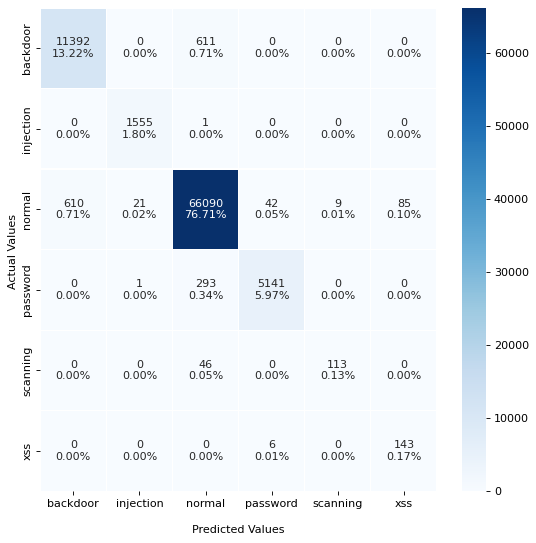

In [ ]:

conf_matrix = confusion_matrix(y_test, y_pred)
group_counts = ["{0:0.0f}".format(value) for value in conf_matrix.flatten()]
group_percentages = ["{0:.2%}".format(value) for value in conf_matrix.flatten()/np.sum(conf_matrix)]
labels = [f"{v1}\n{v2}" for v1, v2 in zip(group_counts,group_percentages)]


fig = plt.figure(num=None, figsize=(8, 8), dpi=80, facecolor='w', edgecolor='k')
labels = np.asarray(labels).reshape(6,6)
ax = sns.heatmap(conf_matrix, annot=labels, fmt="", cmap='Blues',linewidths=0.1)
ax.set_xlabel('\nPredicted Values')
ax.set_ylabel('Actual Values ');

ax.xaxis.set_ticklabels(['backdoor', 'injection', 'normal', 'password', 'scanning', 'xss'])
ax.yaxis.set_ticklabels(['backdoor', 'injection', 'normal', 'password', 'scanning', 'xss'])
plt.show()

In [ ]:

print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

    backdoor       0.95      0.95      0.95     12003
   injection       0.99      1.00      0.99      1556
      normal       0.99      0.99      0.99     66857
    password       0.99      0.95      0.97      5435
    scanning       0.93      0.71      0.80       159
         xss       0.63      0.96      0.76       149

    accuracy                           0.98     86159
   macro avg       0.91      0.93      0.91     86159
weighted avg       0.98      0.98      0.98     86159



**Lime**

In [ ]:
explainer = lime_tabular.LimeTabularExplainer(training_data= np.array(X_train), mode="classification",
                                              class_names=list(definitions),
                                              feature_names= features
                                             )
explainer

In [ ]:
import random as rn 
for i in range(1,4):
    print("Test sample",(i),":")
    idx = rn.randint(0,len(X_test))

    print("Prediction : ", definitions[clf.predict(X_test[idx].reshape(1,-1))[0]])
    print("Actual :     ",  y_test[idx])


    exp = explainer.explain_instance(pd.DataFrame(X_test).iloc[idx], clf.predict_proba,top_labels=4)

    exp.show_in_notebook(show_table = True)
    print()

#IoT Motion Light


In [ ]:
#IoT Motion Light
data = pd.read_csv('/content/drive/MyDrive/ToN_IoT_dataset/Processed_IoT_dataset/IoT_Motion_Light.csv')

In [ ]:
data

,date,time,motion_status,light_status,label,type
0,31-Mar-19,12:36:52,1,on,0,normal
1,31-Mar-19,12:36:53,0,off,0,normal
2,31-Mar-19,12:36:54,0,off,0,normal
3,31-Mar-19,12:36:55,1,on,0,normal
4,31-Mar-19,12:36:56,1,on,0,normal
...,...,...,...,...,...,...
452257,27-Apr-19,12:41:14,0,off,0,normal
452258,27-Apr-19,12:41:18,0,off,0,normal
452259,27-Apr-19,12:41:19,1,on,0,normal
452260,27-Apr-19,12:41:19,1,on,0,normal


In [ ]:
print(data.shape)
print("No of rows",data.shape[0])
print("No of columns",data.shape[1])

(452262, 6)
No of rows 452262
No of columns 6


In [ ]:

inputs = data.drop(['label','type'],axis = 'columns')

target_var_data = data['type']
features = inputs.columns

#Creating the dependent variable class
factor = pd.factorize(data['type'])
target_var = factor[0]
definitions = factor[1]
print(list(definitions))

['normal', 'backdoor', 'ddos', 'injection', 'password', 'ransomware', 'scanning', 'xss']


In [ ]:
le_date = LabelEncoder()
le_time = LabelEncoder()
le_motion_status = LabelEncoder()
le_light_status = LabelEncoder()


In [ ]:
inputs['date_n'] = le_date.fit_transform(inputs['date'])
inputs['time_n'] = le_time.fit_transform(inputs['time'])
inputs['motion_status_n'] = le_motion_status.fit_transform(inputs['motion_status'])
inputs['light_status_n'] = le_light_status.fit_transform(inputs['light_status'])

inputs.head()

,date,time,motion_status,light_status,date_n,time_n,motion_status_n,light_status_n
0,31-Mar-19,12:36:52,1,on,10,79113,1,1
1,31-Mar-19,12:36:53,0,off,10,79114,0,0
2,31-Mar-19,12:36:54,0,off,10,79115,0,0
3,31-Mar-19,12:36:55,1,on,10,79116,1,1
4,31-Mar-19,12:36:56,1,on,10,79117,1,1


In [ ]:
new_inputs = inputs.drop(['date','time','motion_status','light_status'],axis = 'columns')
new_inputs.head()

,date_n,time_n,motion_status_n,light_status_n
0,10,79113,1,1
1,10,79114,0,0
2,10,79115,0,0
3,10,79116,1,1
4,10,79117,1,1


In [ ]:
#split dataset in features and target variable
feature_cols = ['date_n','time_n','motion_status_n','light_status_n']
X = new_inputs[feature_cols] # Features
y = target_var # Target variable

In [ ]:
 #Split dataset into training set and test set
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=1,stratify=pd.DataFrame(y)) # 70% training and 30% test

In [ ]:
scaler = RobustScaler()

X_train = scaler.fit_transform(X_train)

X_test = scaler.transform(X_test)

In [ ]:
#Create a Gaussian Classifier
clf=MLPClassifier(hidden_layer_sizes=(6,5),random_state=5,verbose=True,learning_rate_init=0.01)

#Train the model using the training sets y_pred=clf.predict(X_test)
clf.fit(X_train,y_train)

# prediction on test set
y_pred=clf.predict(X_test)



Iteration 1, loss = 0.31998093
Iteration 2, loss = 0.09043719
Iteration 3, loss = 0.08386676
Iteration 4, loss = 0.08147678
Iteration 5, loss = 0.08032771
Iteration 6, loss = 0.07992403
Iteration 7, loss = 0.07877472
Iteration 8, loss = 0.07830085
Iteration 9, loss = 0.07725110
Iteration 10, loss = 0.07641845
Iteration 11, loss = 0.07490745
Iteration 12, loss = 0.06938295
Iteration 13, loss = 0.06405899
Iteration 14, loss = 0.06247949
Iteration 15, loss = 0.06058946
Iteration 16, loss = 0.05927645
Iteration 17, loss = 0.05926131
Iteration 18, loss = 0.05765770
Iteration 19, loss = 0.05695139
Iteration 20, loss = 0.05681888
Iteration 21, loss = 0.05524814
Iteration 22, loss = 0.05500596
Iteration 23, loss = 0.05456274
Iteration 24, loss = 0.05424860
Iteration 25, loss = 0.05387165
Iteration 26, loss = 0.05324707
Iteration 27, loss = 0.05303331
Iteration 28, loss = 0.05247895
Iteration 29, loss = 0.05226128
Iteration 30, loss = 0.05201007
Iteration 31, loss = 0.05123699
Iteration 32, los

In [ ]:
#Reverse factorize 
reversefactor = dict(zip(range(len(definitions)),definitions))
y_test = np.vectorize(reversefactor.get)(y_test)
y_pred = np.vectorize(reversefactor.get)(y_pred)

In [ ]:
# Model Accuracy, how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test, y_pred))

Accuracy: 0.9846402169827313


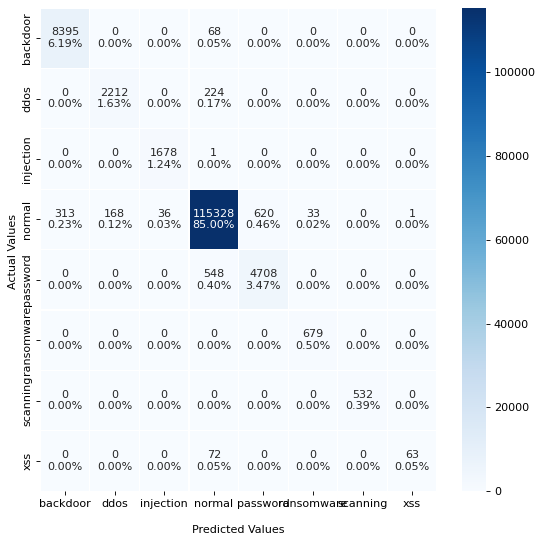

In [ ]:
conf_matrix = confusion_matrix(y_test, y_pred)
group_counts = ["{0:0.0f}".format(value) for value in conf_matrix.flatten()]
group_percentages = ["{0:.2%}".format(value) for value in conf_matrix.flatten()/np.sum(conf_matrix)]
labels = [f"{v1}\n{v2}" for v1, v2 in zip(group_counts,group_percentages)]


fig = plt.figure(num=None, figsize=(8, 8), dpi=80, facecolor='w', edgecolor='k')
labels = np.asarray(labels).reshape(8,8)
ax = sns.heatmap(conf_matrix, annot=labels, fmt="", cmap='Blues',linewidths=0.1)
ax.set_xlabel('\nPredicted Values')
ax.set_ylabel('Actual Values ');

ax.xaxis.set_ticklabels(['backdoor', 'ddos', 'injection', 'normal', 'password','ransomware', 'scanning', 'xss'])
ax.yaxis.set_ticklabels(['backdoor', 'ddos', 'injection', 'normal', 'password','ransomware', 'scanning', 'xss'])
plt.show()

In [ ]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

    backdoor       0.96      0.99      0.98      8463
        ddos       0.93      0.91      0.92      2436
   injection       0.98      1.00      0.99      1679
      normal       0.99      0.99      0.99    116499
    password       0.88      0.90      0.89      5256
  ransomware       0.95      1.00      0.98       679
    scanning       1.00      1.00      1.00       532
         xss       0.98      0.47      0.63       135

    accuracy                           0.98    135679
   macro avg       0.96      0.91      0.92    135679
weighted avg       0.98      0.98      0.98    135679



**Lime**

In [ ]:
explainer = lime_tabular.LimeTabularExplainer(training_data= np.array(X_train), mode="classification",
                                              class_names=list(definitions),
                                              feature_names= features
                                             )
explainer

In [ ]:
import random as rn 
for i in range(1,4):
    print("Test sample",(i),":")
    idx = rn.randint(0,len(X_test))

    print("Prediction : ", definitions[clf.predict(X_test[idx].reshape(1,-1))[0]])
    print("Actual :     ",  y_test[idx])


    exp = explainer.explain_instance(pd.DataFrame(X_test).iloc[idx], clf.predict_proba,top_labels=4)

    exp.show_in_notebook(show_table = True)
    print()

Test sample 1 :
Prediction :  normal
Actual :      normal



Test sample 2 :
Prediction :  normal
Actual :      normal



Test sample 3 :
Prediction :  normal
Actual :      normal


#IoT Thermostat


In [ ]:
#IoT Thermostat
data = pd.read_csv('/content/drive/MyDrive/ToN_IoT_dataset/Processed_IoT_dataset/IoT_Thermostat.csv')

In [ ]:
data

,date,time,current_temperature,thermostat_status,label,type
0,31-Mar-19,12:36:52,25.000000,0,0,normal
1,31-Mar-19,12:36:53,25.000000,0,0,normal
2,31-Mar-19,12:36:54,25.000000,0,0,normal
3,31-Mar-19,12:36:55,25.000000,0,0,normal
4,31-Mar-19,12:36:56,25.000000,0,0,normal
...,...,...,...,...,...,...
442223,27-Apr-19,12:41:14,29.804525,1,0,normal
442224,27-Apr-19,12:41:18,25.824332,1,0,normal
442225,27-Apr-19,12:41:19,27.248819,1,0,normal
442226,27-Apr-19,12:41:19,29.739201,1,0,normal


In [ ]:
data.isnull().sum()

date                   4621
time                   4621
current_temperature       0
thermostat_status         0
label                     0
type                      0
dtype: int64

In [ ]:
data = data.dropna(axis = 0,subset=['date', 'time'])

In [ ]:
print(data.shape)
print("No of rows",data.shape[0])
print("No of columns",data.shape[1])

(437607, 6)
No of rows 437607
No of columns 6


In [ ]:

inputs = data.drop(['label','type'],axis = 'columns')

target_var_data = data['type']
features = inputs.columns

#Creating the dependent variable class
factor = pd.factorize(data['type'])
target_var = factor[0]
definitions = factor[1]
print(list(definitions))

['normal', 'backdoor', 'injection', 'password', 'ransomware', 'scanning', 'xss']


In [ ]:
le_date = LabelEncoder()

le_time = LabelEncoder()
le_current_temperature = LabelEncoder()
le_thermostat_status = LabelEncoder()


In [ ]:
inputs['date_n'] = le_date.fit_transform(inputs['date'].astype('str'))
inputs['time_n'] = le_time.fit_transform(inputs['time'].astype('str'))
inputs['current_temperature_n'] = le_current_temperature.fit_transform(inputs['current_temperature'].astype('str'))
inputs['thermostat_status_n'] = le_thermostat_status.fit_transform(inputs['thermostat_status'].astype('str'))

inputs.head()

,date,time,current_temperature,thermostat_status,date_n,time_n,current_temperature_n,thermostat_status_n
0,31-Mar-19,12:36:52,25.0,0,10,79408,0,0
1,31-Mar-19,12:36:53,25.0,0,10,79409,0,0
2,31-Mar-19,12:36:54,25.0,0,10,79410,0,0
3,31-Mar-19,12:36:55,25.0,0,10,79411,0,0
4,31-Mar-19,12:36:56,25.0,0,10,79412,0,0


In [ ]:
new_inputs = inputs.drop(['date','time','current_temperature','thermostat_status'],axis = 'columns')
new_inputs.head()

,date_n,time_n,current_temperature_n,thermostat_status_n
0,10,79408,0,0
1,10,79409,0,0
2,10,79410,0,0
3,10,79411,0,0
4,10,79412,0,0


In [ ]:
#split dataset in features and target variable
feature_cols = ['date_n','time_n','current_temperature_n','thermostat_status_n']
X = new_inputs[feature_cols] # Features
y = target_var # Target variable

In [ ]:
#Split dataset into training set and test set
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=1,stratify=pd.DataFrame(y)) # 70% training and 30% test

In [ ]:
scaler = RobustScaler()

X_train = scaler.fit_transform(X_train)

X_test = scaler.transform(X_test)

In [ ]:
#Create a Gaussian Classifier
clf=MLPClassifier(hidden_layer_sizes=(6,5),random_state=5,verbose=True,learning_rate_init=0.01)

#Train the model using the training sets y_pred=clf.predict(X_test)
clf.fit(X_train,y_train)

# prediction on test set
y_pred=clf.predict(X_test)



Iteration 1, loss = 0.15949519
Iteration 2, loss = 0.06235388
Iteration 3, loss = 0.05304730
Iteration 4, loss = 0.04381432
Iteration 5, loss = 0.03591281
Iteration 6, loss = 0.03225073
Iteration 7, loss = 0.03049243
Iteration 8, loss = 0.02904343
Iteration 9, loss = 0.02814299
Iteration 10, loss = 0.02802927
Iteration 11, loss = 0.02761182
Iteration 12, loss = 0.02729319
Iteration 13, loss = 0.02731460
Iteration 14, loss = 0.02688891
Iteration 15, loss = 0.02526748
Iteration 16, loss = 0.02538268
Iteration 17, loss = 0.02526006
Iteration 18, loss = 0.02465177
Iteration 19, loss = 0.02505454
Iteration 20, loss = 0.02444365
Iteration 21, loss = 0.02446050
Iteration 22, loss = 0.02428182
Iteration 23, loss = 0.02396826
Iteration 24, loss = 0.02440591
Iteration 25, loss = 0.02451543
Iteration 26, loss = 0.02403636
Iteration 27, loss = 0.02400729
Iteration 28, loss = 0.02426211
Iteration 29, loss = 0.02419498
Iteration 30, loss = 0.02413090
Iteration 31, loss = 0.02389606
Iteration 32, los

In [ ]:
#Reverse factorize 
reversefactor = dict(zip(range(len(definitions)),definitions))
y_test = np.vectorize(reversefactor.get)(y_test)
y_pred = np.vectorize(reversefactor.get)(y_pred)

In [ ]:
# Model Accuracy, how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test, y_pred))

Accuracy: 0.9926799357114021


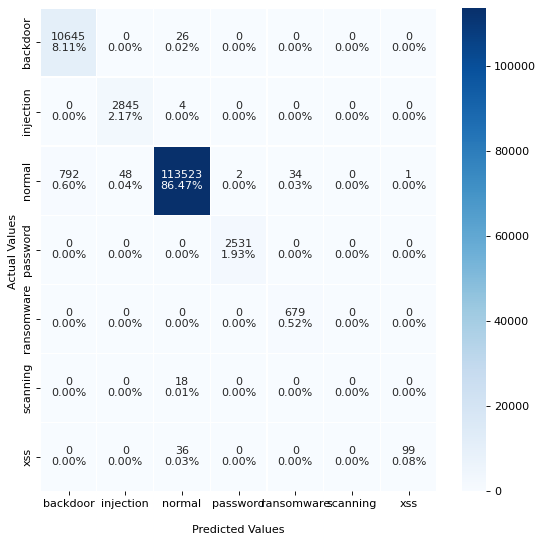

In [ ]:
conf_matrix = confusion_matrix(y_test, y_pred)
group_counts = ["{0:0.0f}".format(value) for value in conf_matrix.flatten()]
group_percentages = ["{0:.2%}".format(value) for value in conf_matrix.flatten()/np.sum(conf_matrix)]
labels = [f"{v1}\n{v2}" for v1, v2 in zip(group_counts,group_percentages)]


fig = plt.figure(num=None, figsize=(8, 8), dpi=80, facecolor='w', edgecolor='k')
labels = np.asarray(labels).reshape(7,7)
ax = sns.heatmap(conf_matrix, annot=labels, fmt="", cmap='Blues',linewidths=0.1)
ax.set_xlabel('\nPredicted Values')
ax.set_ylabel('Actual Values ');

ax.xaxis.set_ticklabels(['backdoor', 'injection', 'normal', 'password', 'ransomware','scanning', 'xss'])
ax.yaxis.set_ticklabels(['backdoor', 'injection', 'normal', 'password', 'ransomware','scanning', 'xss'])
plt.show()

In [ ]:
print(classification_report(y_test, y_pred))

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

    backdoor       0.93      1.00      0.96     10671
   injection       0.98      1.00      0.99      2849
      normal       1.00      0.99      1.00    114400
    password       1.00      1.00      1.00      2531
  ransomware       0.95      1.00      0.98       679
    scanning       0.00      0.00      0.00        18
         xss       0.99      0.73      0.84       135

    accuracy                           0.99    131283
   macro avg       0.84      0.82      0.82    131283
weighted avg       0.99      0.99      0.99    131283



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


**Lime**

In [ ]:
explainer = lime_tabular.LimeTabularExplainer(training_data= np.array(X_train), mode="classification",
                                              class_names=list(definitions),
                                              feature_names= features
                                             )
explainer

In [ ]:
import random as rn 
for i in range(1,4):
    print("Test sample",(i),":")
    idx = rn.randint(0,len(X_test))

    print("Prediction : ", definitions[clf.predict(X_test[idx].reshape(1,-1))[0]])
    print("Actual :     ",  y_test[idx])


    exp = explainer.explain_instance(pd.DataFrame(X_test).iloc[idx], clf.predict_proba,top_labels=4)

    exp.show_in_notebook(show_table = True)
    print()

Test sample 1 :
Prediction :  normal
Actual :      normal



Test sample 2 :
Prediction :  backdoor
Actual :      backdoor



Test sample 3 :
Prediction :  normal
Actual :      normal


#IoT Weather


In [ ]:
#IoT Weather
data = pd.read_csv('/content/drive/MyDrive/ToN_IoT_dataset/Processed_IoT_dataset/IoT_Weather.csv')

In [ ]:
data

,date,time,temperature,pressure,humidity,label,type
0,31-Mar-19,12:36:52,31.788508,1.035000,32.036579,0,normal
1,31-Mar-19,12:36:53,41.630997,1.035000,30.886165,0,normal
2,31-Mar-19,12:36:54,42.256959,1.035000,19.755908,0,normal
3,31-Mar-19,12:36:55,49.116581,1.035000,78.949621,0,normal
4,31-Mar-19,12:36:56,24.017085,1.035000,40.001059,0,normal
...,...,...,...,...,...,...,...
650237,27-Apr-19,12:41:17,40.384291,9.049059,93.094490,0,normal
650238,27-Apr-19,12:41:18,47.240113,-5.782022,28.146511,0,normal
650239,27-Apr-19,12:41:18,23.540606,0.913648,30.478316,0,normal
650240,27-Apr-19,12:41:18,46.016150,3.493588,73.328413,0,normal


In [ ]:
print(data.shape)
print("No of rows",data.shape[0])
print("No of columns",data.shape[1])

(650242, 7)
No of rows 650242
No of columns 7


In [ ]:

inputs = data.drop(['label','type'],axis = 'columns')

target_var_data = data['type']
features = inputs.columns

#Creating the dependent variable class
factor = pd.factorize(data['type'])
target_var = factor[0]
definitions = factor[1]
print(list(definitions))

['normal', 'backdoor', 'ddos', 'injection', 'password', 'ransomware', 'scanning', 'xss']


In [ ]:
le_date = LabelEncoder()
le_time = LabelEncoder()
le_temperature = LabelEncoder()
le_pressure = LabelEncoder()
le_humidity = LabelEncoder()

In [ ]:
inputs['date_n'] = le_date.fit_transform(inputs['date'])
inputs['time_n'] = le_time.fit_transform(inputs['time'])
inputs['temperature_n'] = le_temperature.fit_transform(inputs['temperature'])
inputs['pressure_n'] = le_pressure.fit_transform(inputs['pressure'])
inputs['humidity_n'] = le_humidity.fit_transform(inputs['humidity'])
inputs.head()

,date,time,temperature,pressure,humidity,date_n,time_n,temperature_n,pressure_n,humidity_n
0,31-Mar-19,12:36:52,31.788508,1.035,32.036579,11,77572,187945,32817,29574
1,31-Mar-19,12:36:53,41.630997,1.035,30.886165,11,77573,388149,32817,28321
2,31-Mar-19,12:36:54,42.256959,1.035,19.755908,11,77574,402748,32817,16911
3,31-Mar-19,12:36:55,49.116581,1.035,78.949621,11,77575,562045,32817,83485
4,31-Mar-19,12:36:56,24.017085,1.035,40.001059,11,77576,53759,32817,38182


In [ ]:
new_inputs = inputs.drop(['date','time','temperature','pressure','humidity'],axis = 'columns')
new_inputs.head()

,date_n,time_n,temperature_n,pressure_n,humidity_n
0,11,77572,187945,32817,29574
1,11,77573,388149,32817,28321
2,11,77574,402748,32817,16911
3,11,77575,562045,32817,83485
4,11,77576,53759,32817,38182


In [ ]:
#split dataset in features and target variable
feature_cols = ['date_n', 'time_n', 'temperature_n', 'pressure_n', 'humidity_n']
X = new_inputs[feature_cols] # Features
y = target_var # Target variable

In [ ]:
# Split dataset into training set and test set
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=1,stratify=pd.DataFrame(y)) # 70% training and 30% test

In [ ]:
scaler = RobustScaler()

X_train = scaler.fit_transform(X_train)

X_test = scaler.transform(X_test)

In [ ]:
#Create a Gaussian Classifier
clf=MLPClassifier(hidden_layer_sizes=(6,5),random_state=5,verbose=True,learning_rate_init=0.01)

#Train the model using the training sets y_pred=clf.predict(X_test)
clf.fit(X_train,y_train)

# prediction on test set
y_pred=clf.predict(X_test)


Iteration 1, loss = 0.20725707
Iteration 2, loss = 0.07107853
Iteration 3, loss = 0.06153721
Iteration 4, loss = 0.05875697
Iteration 5, loss = 0.05784013
Iteration 6, loss = 0.05695093
Iteration 7, loss = 0.05613546
Iteration 8, loss = 0.05650352
Iteration 9, loss = 0.05601122
Iteration 10, loss = 0.05533852
Iteration 11, loss = 0.05523131
Iteration 12, loss = 0.05479803
Iteration 13, loss = 0.05497026
Iteration 14, loss = 0.05427823
Iteration 15, loss = 0.05466248
Iteration 16, loss = 0.05399834
Iteration 17, loss = 0.05400350
Iteration 18, loss = 0.05373388
Iteration 19, loss = 0.05368596
Iteration 20, loss = 0.05341243
Iteration 21, loss = 0.05310421
Iteration 22, loss = 0.05298076
Iteration 23, loss = 0.05270272
Iteration 24, loss = 0.05287272
Iteration 25, loss = 0.05227465
Iteration 26, loss = 0.05254536
Iteration 27, loss = 0.05222749
Iteration 28, loss = 0.05203119
Iteration 29, loss = 0.05221273
Iteration 30, loss = 0.05190777
Iteration 31, loss = 0.05220091
Iteration 32, los

In [ ]:
#Reverse factorize 
reversefactor = dict(zip(range(len(definitions)),definitions))
y_test = np.vectorize(reversefactor.get)(y_test)
y_pred = np.vectorize(reversefactor.get)(y_pred)

In [ ]:
# Model Accuracy, how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test, y_pred))

Accuracy: 0.9820221147980499


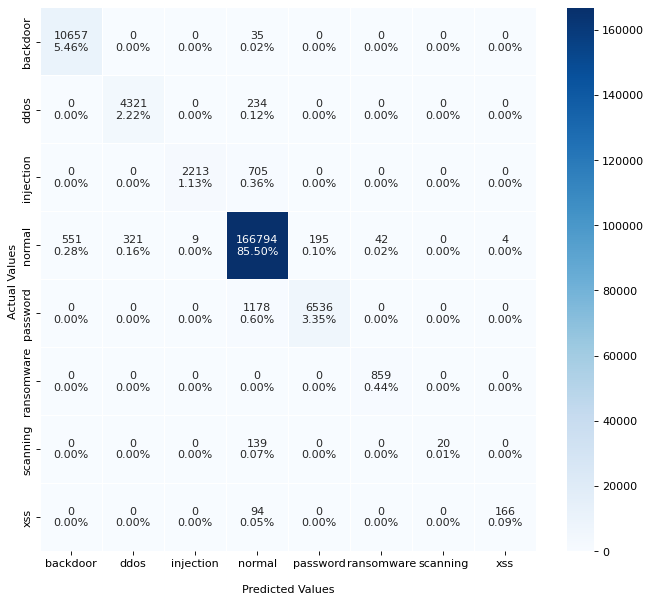

In [ ]:
conf_matrix = confusion_matrix(y_test, y_pred)
group_counts = ["{0:0.0f}".format(value) for value in conf_matrix.flatten()]
group_percentages = ["{0:.2%}".format(value) for value in conf_matrix.flatten()/np.sum(conf_matrix)]
labels = [f"{v1}\n{v2}" for v1, v2 in zip(group_counts,group_percentages)]


fig = plt.figure(num=None, figsize=(10, 9), dpi=80, facecolor='w', edgecolor='k')
labels = np.asarray(labels).reshape(8,8)
ax = sns.heatmap(conf_matrix, annot=labels, fmt="", cmap='Blues',linewidths=0.1)
ax.set_xlabel('\nPredicted Values')
ax.set_ylabel('Actual Values ');

ax.xaxis.set_ticklabels(['backdoor', 'ddos', 'injection', 'normal', 'password','ransomware', 'scanning', 'xss'])
ax.yaxis.set_ticklabels(['backdoor', 'ddos', 'injection', 'normal', 'password','ransomware', 'scanning', 'xss'])
plt.show()

In [ ]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

    backdoor       0.95      1.00      0.97     10692
        ddos       0.93      0.95      0.94      4555
   injection       1.00      0.76      0.86      2918
      normal       0.99      0.99      0.99    167916
    password       0.97      0.85      0.90      7714
  ransomware       0.95      1.00      0.98       859
    scanning       1.00      0.13      0.22       159
         xss       0.98      0.64      0.77       260

    accuracy                           0.98    195073
   macro avg       0.97      0.79      0.83    195073
weighted avg       0.98      0.98      0.98    195073



**Lime**

In [ ]:
explainer = lime_tabular.LimeTabularExplainer(training_data= np.array(X_train), mode="classification",
                                              class_names=list(definitions),
                                              feature_names= features
                                             )
explainer

In [ ]:
import random as rn 

for i in range(1,4):
    print("Test sample",(i),":")
    idx = rn.randint(0,len(X_test))

    print("Prediction : ", definitions[clf.predict(X_test[idx].reshape(1,-1))[0]])
    print("Actual :     ",  y_test[idx])


    exp = explainer.explain_instance(pd.DataFrame(X_test).iloc[idx], clf.predict_proba,top_labels=4)

    exp.show_in_notebook(show_table = True)
    print()

**Wrong Prediction**

In [ ]:
false_preds = np.argwhere((y_pred != y_test)).flatten()

idx  = rn.choice(false_preds)
print("Prediction : ", definitions[clf.predict(X_test[idx].reshape(1,-1))[0]])
print("Actual :     ",  y_test[idx])


exp = explainer.explain_instance(pd.DataFrame(X_test).iloc[idx], clf.predict_proba,top_labels=4)

exp.show_in_notebook(show_table = True)


Prediction :  normal
Actual :      injection


In [ ]:
temp_list = []
for i in range(1,4):
    print("Test sample",(i),":")
    while True:

      x = rn.randint(0,len(X_test))
      pred = definitions[clf.predict(X_test[x].reshape(1,-1))[0]]
      if (pred) not in temp_list:
          idx = x
          break

    print("Prediction : ", pred)
    print("Actual :     ",  y_test[idx])


    exp = explainer.explain_instance(pd.DataFrame(X_test).iloc[idx], clf.predict_proba,top_labels=4)

    exp.show_in_notebook(show_table = True)
    print()